In [511]:
import numpy as np
import matplotlib.pyplot as plt
import nugridpy.mesa as ms
import planet_prop as pp
import os
import shutil
%matplotlib inline
import matplotlib as mpl
from scipy.interpolate import interp1d

mpl.rcParams['xtick.labelsize']=16
mpl.rcParams['ytick.labelsize']=16
plt.rc('text', usetex=True)
plt.rc('font', family='serif')

Set-up the grid structures

In [462]:
NL=96
Nenv=128

L_M_min=6e-8
L_M_max=1e2
Xmax=10.
Xmin=0.001

Mcore_grid_big=np.linspace(2.5,9.625,39)

Period=11.567 *86400.
Omega=2.*np.pi/Period
a_sep=(6.67e-8*2e33/Omega**2.)**(1./3.)
Fearth=3.83e33/(4.*np.pi*1.5e13**2.)
Lmod=5.6704e-5*4280.4**4.*(4.*np.pi*(1.6776*pp.rsun)**2.)
Fmod=Lmod/(4.*np.pi*a_sep**2.)

Xgrid=np.logspace(np.log10(Xmax),np.log10(Xmin),Nenv)

L_M_grid=np.logspace(np.log10(L_M_min),np.log10(L_M_max),NL)

print(Mcore_grid_big[13])

4.9375


In [3]:
class mesa_data:
    def __init__(self):
        self.time=[]
        self.radius=[]
        self.exist=False

class mesa_Xenv_L_array:
    def __init__(self,nenv,nl):
        self.evol = [[mesa_data() for j in range(nl)] for i in range(nenv)]

In [4]:
data_big=[mesa_Xenv_L_array(Nenv,NL) for i in range(np.size(Mcore_grid_big))]

In [29]:
print(data_big[0].evol[0][0].exist)

False


In [5]:
c_t_out = []

make_plot=True

#mean_Xinit = np.zeros(25)
#c_t_mean = np.zeros(25)

for kM in range(39):
    os.chdir("/mnt/data/jeowen/Young_planets_2/Young_planets_2/Model_%d" %(kM))
    os.chdir("planets")
    X_final=[]
    R_final=[]
    X_init =[]
    cooling_t=[]

    Mcore_grid = Mcore_grid_big[kM]
    Rock_fraction=2./3.
    Rcore=(0.0592*Rock_fraction+0.0975)*(np.log10(Mcore_grid))**2.+(0.2337*Rock_fraction+0.4938)*np.log10(Mcore_grid)+(0.3102*Rock_fraction+0.7932)
    
    for i in range(0,Nenv):
        for j in range(0,NL):
            f_nm="e_his_%d_L%d.data" %(i,j)
            if os.path.isfile(f_nm):
                statinfo = os.stat(f_nm)
                if (statinfo.st_size == 0):
                    break
                #print(kM,i,j)
                shutil.copyfile(f_nm,"history.data")
                his=ms.history_data('.',clean_starlog=True)
                mass=his.get('star_mass')*pp.msun
                time=his.get('star_age')
                radius=(10.**his.get('log_R'))*pp.rsun
                X=(mass-Mcore_grid*pp.mearth)/(Mcore_grid*pp.mearth)
                lum=his.get('luminosity')*pp.lsun
                centre_rho=10.**(his.get('log_center_Rho'))
                centre_P=10.**(his.get('log_center_P'))
                centre_T=10.**(his.get('log_center_T'))
                khtime=his.get('kh_timescale') # in years
                # now adjust khtime
                cooling_time=khtime[0]*lum[0]/(L_M_grid[j]*mass[0])
                
                surf_T = 10.**(his.get('log_Teff'))
                cs = np.sqrt(1.38e-16*surf_T[0]/(2.35*1.67e-24))
                
                Rbondi = 6.67e-8 * mass[0]/2./cs**2.
                
                Rp_Rbondi_init = radius[0] / Rbondi
                
                if (cooling_time < 5e50) & (cooling_time > 1):
                    #print (i,mass/pp.mearth)
                    get_rad = interp1d(time,radius/pp.rearth,bounds_error=False)
                    get_mass = interp1d(time,mass/pp.mearth,bounds_error=False)
                    rad_time = get_rad(5e7)
                    mass_time = get_mass(5e7)
                    if ((rad_time > 7.-40.*0.7) & (rad_time < 7.+40.*0.7) & (make_plot)):
                        #plt.loglog(time,X,'k')
                    
                        # radius withing 4 sigma of required value at mean age so store data
                        data_big[kM].evol[i][j].exist=True
                        data_big[kM].evol[i][j].tkh_init = cooling_time
                        data_big[kM].evol[i][j].get_rad = get_rad
                        data_big[kM].evol[i][j].get_mass = get_mass
                        data_big[kM].evol[i][j].X_init = X[0]
                        data_big[kM].evol[i][j].X_final = X[-1]
                        data_big[kM].evol[i][j].Rp_Rb_init = Rp_Rbondi_init
                    
                        #data_out = np.zeros((np.size(time),3))
                        #data_out[:,0]=time
                        #data_out[:,1]=radius/pp.rearth
                        #data_out[:,2]=X
                    
                        #np.save('../b_data',data_out)
                    
                        #make_plot=False
                    
                    #X_final=np.append(X_final,X[-1])
                    #if X[-1] < 3e-5:
                    #    radius[-1]=Rcore*pp.rearth
                    #R_final=np.append(R_final,radius[-1]/pp.rearth)
                
                    #break
                    
    #mean_Xinit[kM] = np.mean(X_init)
    #c_t_mean[kM] = np.mean(cooling_t)
    
    
    
#os.chdir("/scratch/jowen/kepler36b/")
#print (c_t_out)
#plt.errorbar(5e7,7.,yerr=0.6,fmt='or')
#plt.ylim(1e-2,10.)

#plt.figure()
#plt.hist(np.log10(c_t_out))

No history.datasa file found, create new one from history.data
 reading ...96% 

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 




Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool .

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 




Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.da

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clos

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clos

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clo

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool .

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.data

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.data

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing 

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.dat

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.data

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing 

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
No history.datasa file found, create new one from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new histor

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.d

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new histor

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.data

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.da

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datas

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.dat

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
No history.datasa file found, create new one from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.da

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datas

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datas

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datas

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

C

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.data

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.data

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.dat

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.dat

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Cl

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new histor

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing 

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.d

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.dat

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.d

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing hi

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
No history.datasa file found, create new one from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.da

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clos

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datas

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histor

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new histo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing 

 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing 

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing h

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Cl

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

C

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing hi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clos

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing hi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Clo

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing h

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closi

 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...96% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clos

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Clo

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closi

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Clos

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing 

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...98% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Cl

 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...97% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closin

 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 

Closing history.data  tool ...
Requested new history.datasa; create new from history.data
 reading ...100% 



In [171]:
# make a 3D array of tKH_init

log_tkh_init = np.zeros((np.size(Mcore_grid_big),Nenv,NL)) + np.nan
Rp_init = np.zeros((np.size(Mcore_grid_big),Nenv,NL)) + np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        for j in range(NL):
            if (data_big[kM].evol[i][j].exist):
                log_tkh_init[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                #Rp_init[kM,i,j] = (data_big[kM].evol[i][j].X_init)




            
            

In [89]:
#
from scipy.special import erf

def get_prob_phot(Tphot,Star_age,age_err,Tdisc0,Tdisc_spread):
    
    # evaluates the probability that the planet has experienced Tphot of photoevaporation evolution
    # all times in Myr
    mu_p = Tphot-Star_age
    
    exp_factor = (age_err**2.+2.*Tdisc_spread*(mu_p+Tdisc0))/(2.*Tdisc_spread**2.)
    erf_factor = (age_err**2.+Tdisc_spread*(mu_p+Tdisc0))/(np.sqrt(2.)*age_err*Tdisc_spread)
    
    prob_Tphot = np.exp(exp_factor)/2./Tdisc_spread*(1.-erf(erf_factor))
    
    return prob_Tphot
    

In [147]:
tkh_init_grid = np.logspace(6.,10.,30)

time_after_disc = np.linspace(25.,75.,30)

Lik = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 5.
Mp_error = 0.5

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
    
        
        
        

/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in greater


/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: divide by zero encountered in log10
  # Remove the CWD from sys.path while we load stuff.


1.6836526650419728


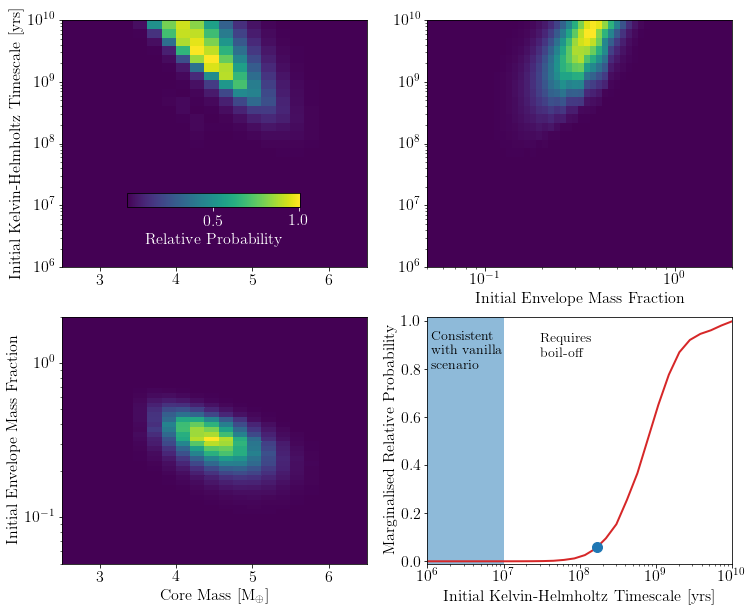

In [225]:
Lik[np.isnan(Lik)] = 0.
Lik_ = np.trapz(Lik,time_after_disc,axis=3)
L_int_X = -np.trapz(Lik_,np.log10(Xgrid),axis=1)
L_int1_Mc = np.trapz(Lik_,Mcore_grid_big,axis=0)
L_int1_tkh = np.trapz(Lik_,np.log10(tkh_init_grid),axis=2)
L_int_Mc = np.trapz(L_int_X,Mcore_grid_big,axis=0)

from scipy.integrate import cumtrapz
cum_prob = cumtrapz(L_int_Mc,np.log10(tkh_init_grid),initial=0.)/np.trapz(L_int_Mc,np.log10(tkh_init_grid))
get_prob = interp1d(np.log10(cum_prob),np.log10(tkh_init_grid))
get_pdf = interp1d(np.log10(tkh_init_grid),L_int_Mc/np.amax(L_int_Mc))


#Lik2[np.isnan(Lik2)] = 0.
#Lik2_ = np.trapz(Lik2,time_after_disc,axis=3)
#L_int_X2 = -np.trapz(Lik2_,np.log10(Xgrid),axis=1)
#L_int_Mc2 = np.trapz(L_int_X2,Mcore_grid_big,axis=0)

#Lik3[np.isnan(Lik3)] = 0.
#Lik3_ = np.trapz(Lik3,time_after_disc,axis=3)
#L_int_X3 = -np.trapz(Lik3_,np.log10(Xgrid),axis=1)
#L_int_Mc3 = np.trapz(L_int_X3,Mcore_grid_big,axis=0)

#print(L_int_X)

fig,ax = plt.subplots(2,2,figsize=(12,10))

c=ax[0,0].pcolormesh(Mcore_grid_big,(tkh_init_grid),(L_int_X.T+1e-3)/np.amax(L_int_X))
ax[0,0].set_yscale('log')
ax[0,0].set_xlim((2.5,6.5))
ax[0,0].set_ylabel('Initial Kelvin-Helmholtz Timescale [yrs]',fontsize=16)
#plt.colorbar()
#plt.figure()
ax[0,1].pcolormesh((Xgrid),(tkh_init_grid),(L_int1_Mc.T+1e-3)/np.amax(L_int1_Mc))
ax[0,1].set_xscale('log')
ax[0,1].set_yscale('log')
ax[0,1].set_xlim((5e-2,2.))
ax[0,1].set_xlabel('Initial Envelope Mass Fraction',fontsize=16)
#plt.colorbar()
#plt.figure()
ax[1,0].pcolormesh(Mcore_grid_big,(Xgrid),(L_int1_tkh.T+1e-3)/np.amax(L_int1_tkh))
ax[1,0].set_xlim((2.5,6.5))
ax[1,0].set_ylim((5e-2,2.))
ax[1,0].set_yscale('log')
ax[1,0].set_ylabel('Initial Envelope Mass Fraction',fontsize=16)
ax[1,0].set_xlabel(r'Core Mass [M$_\oplus$]',fontsize=16)
#plt.colorbar()

#plt.figure()
ax[1,1].semilogx(tkh_init_grid,L_int_Mc/np.amax(L_int_Mc),'C3',lw=2)
ax[1,1].set_xlim((1e6,1e10))
ax[1,1].fill_between([1e6,1e7],[-0.5,-0.5],[2.,2.],alpha=0.5)
ax[1,1].set_ylim((-0.01,1.02))
ax[1,1].text(1.1e6,0.8,"Consistent \n with vanilla \n scenario",fontsize=14)
ax[1,1].text(3e7,0.85,"Requires \n boil-off",fontsize=14)
ax[1,1].set_xlabel('Initial Kelvin-Helmholtz Timescale [yrs]',fontsize=16)
ax[1,1].set_ylabel('Marginalised Relative Probability',fontsize=16)
ax[1,1].plot((10.**get_prob(np.log10(0.01))),get_pdf(get_prob(np.log10(0.01))),'oC0',markersize=10)
print(10.**get_prob(np.log10(0.01))/1e8)
#plt.semilogx(tkh_init_grid,L_int_Mc2/np.amax(L_int_Mc2),'--')
#plt.semilogx(tkh_init_grid,L_int_Mc3/np.amax(L_int_Mc3),':')


cbaxes = fig.add_axes([0.2, 0.62, 0.2, 0.02]) 
cb = plt.colorbar(c, cax=cbaxes, orientation='horizontal')
cb.ax.xaxis.set_tick_params(color='white')
plt.setp(plt.getp(cb.ax.axes, 'xticklabels'), color='white')
cb.set_label('Relative Probability', color='white',fontsize=16)
#from scipy.integrate import cumtrapz

#plt.figure()
#plt.semilogx(tkh_init_grid,cumtrapz(L_int_Mc3,np.log10(tkh_init_grid),initial=0.)/np.trapz(L_int_Mc3,np.log10(tkh_init_grid)))

plt.savefig('/home/jeowen/Dropbox/Apps/Overleaf/Young_planets/Panel_plot.pdf',bbox_inches='tight')

In [226]:
tkh_init_grid = np.logspace(6.,10.,30)

time_after_disc = np.linspace(25.,75.,30)

Lik0 = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 4.
Mp_error = 0.4

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik0[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik0[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik0[np.isnan(Lik0)] = 0.
Lik0_ = np.trapz(Lik0,time_after_disc,axis=3)
L_int_X0 = -np.trapz(Lik0_,np.log10(Xgrid),axis=1)
L_int1_Mc0 = np.trapz(Lik0_,Mcore_grid_big,axis=0)
L_int1_tkh0 = np.trapz(Lik0_,np.log10(tkh_init_grid),axis=2)
L_int_Mc0 = np.trapz(L_int_X0,Mcore_grid_big,axis=0)


Lik2 = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 6.
Mp_error = 0.6

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik2[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik2[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik2[np.isnan(Lik2)] = 0.
Lik2_ = np.trapz(Lik2,time_after_disc,axis=3)
L_int_X2 = -np.trapz(Lik2_,np.log10(Xgrid),axis=1)
L_int1_Mc2 = np.trapz(Lik2_,Mcore_grid_big,axis=0)
L_int1_tkh2 = np.trapz(Lik2_,np.log10(tkh_init_grid),axis=2)
L_int_Mc2 = np.trapz(L_int_X2,Mcore_grid_big,axis=0)


Lik3 = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 7.
Mp_error = 0.7

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik3[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik3[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik3[np.isnan(Lik3)] = 0.
Lik3_ = np.trapz(Lik3,time_after_disc,axis=3)
L_int_X3 = -np.trapz(Lik3_,np.log10(Xgrid),axis=1)
L_int1_Mc3 = np.trapz(Lik3_,Mcore_grid_big,axis=0)
L_int1_tkh3 = np.trapz(Lik3_,np.log10(tkh_init_grid),axis=2)
L_int_Mc3 = np.trapz(L_int_X3,Mcore_grid_big,axis=0)

Lik4 = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 8.
Mp_error = 0.8

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik4[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik4[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik4[np.isnan(Lik4)] = 0.
Lik4_ = np.trapz(Lik4,time_after_disc,axis=3)
L_int_X4 = -np.trapz(Lik4_,np.log10(Xgrid),axis=1)
L_int1_Mc4 = np.trapz(Lik4_,Mcore_grid_big,axis=0)
L_int1_tkh4 = np.trapz(Lik4_,np.log10(tkh_init_grid),axis=2)
L_int_Mc4 = np.trapz(L_int_X4,Mcore_grid_big,axis=0)

/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:134: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:204: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:205: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:274: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:275: Runtime

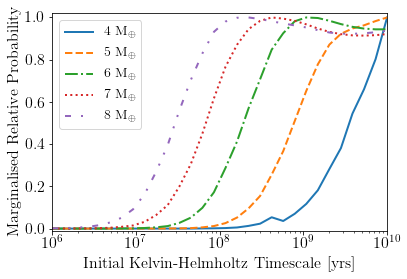

In [231]:
plt.semilogx(tkh_init_grid,L_int_Mc0/np.amax(L_int_Mc0),lw=2,label=r'4~M$_\oplus$')
plt.semilogx(tkh_init_grid,L_int_Mc/np.amax(L_int_Mc),'--',lw=2,label=r'5~M$_\oplus$')
plt.semilogx(tkh_init_grid,L_int_Mc2/np.amax(L_int_Mc2),'-.',lw=2,label=r'6~M$_\oplus$')
plt.semilogx(tkh_init_grid,L_int_Mc3/np.amax(L_int_Mc3),':',lw=2,label=r'7~M$_\oplus$')
plt.semilogx(tkh_init_grid,L_int_Mc4/np.amax(L_int_Mc4),linestyle=(0, (3, 5, 1, 5, 1, 5)),lw=2,label=r'8~M$_\oplus$')
plt.xlim((1e6,1e10))
#ax[1,1].fill_between([1e6,1e7],[-0.5,-0.5],[2.,2.],alpha=0.5)
plt.ylim((-0.01,1.02))
#ax[1,1].text(1.1e6,0.8,"Consistent \n with vanilla \n scenario",fontsize=14)
#ax[1,1].text(3e7,0.85,"Requires \n boil-off",fontsize=14)
plt.xlabel('Initial Kelvin-Helmholtz Timescale [yrs]',fontsize=16)
plt.ylabel('Marginalised Relative Probability',fontsize=16)
plt.legend(loc=0,fontsize=14)
plt.savefig('/home/jeowen/Dropbox/Apps/Overleaf/Young_planets/Vary_mass.pdf',bbox_inches='tight')

In [232]:
tkh_init_grid = np.logspace(6.,10.,30)

time_after_disc = np.linspace(25.,75.,30)

Lik0a = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 5.
Mp_error = 0.25

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik0a[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik0a[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik0a[np.isnan(Lik0a)] = 0.
Lik0a_ = np.trapz(Lik0a,time_after_disc,axis=3)
L_int_X0a = -np.trapz(Lik0a_,np.log10(Xgrid),axis=1)
L_int1_Mc0a = np.trapz(Lik0a_,Mcore_grid_big,axis=0)
L_int1_tkh0a = np.trapz(Lik0a_,np.log10(tkh_init_grid),axis=2)
L_int_Mc0a = np.trapz(L_int_X0a,Mcore_grid_big,axis=0)


Lik2a = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 5.
Mp_error = 0.75

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik2a[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik2a[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik2a[np.isnan(Lik2a)] = 0.
Lik2a_ = np.trapz(Lik2a,time_after_disc,axis=3)
L_int_X2a = -np.trapz(Lik2a_,np.log10(Xgrid),axis=1)
L_int1_Mc2a = np.trapz(Lik2a_,Mcore_grid_big,axis=0)
L_int1_tkh2a = np.trapz(Lik2a_,np.log10(tkh_init_grid),axis=2)
L_int_Mc2a = np.trapz(L_int_X2a,Mcore_grid_big,axis=0)


Lik3a = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 5.
Mp_error = 1.

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik3a[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik3a[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik3a[np.isnan(Lik3a)] = 0.
Lik3a_ = np.trapz(Lik3a,time_after_disc,axis=3)
L_int_X3a = -np.trapz(Lik3a_,np.log10(Xgrid),axis=1)
L_int1_Mc3a = np.trapz(Lik3a_,Mcore_grid_big,axis=0)
L_int1_tkh3a = np.trapz(Lik3a_,np.log10(tkh_init_grid),axis=2)
L_int_Mc3a = np.trapz(L_int_X3a,Mcore_grid_big,axis=0)

/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:133: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:134: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:204: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:205: RuntimeWarning: invalid value encountered in greater


In [233]:
Lik4a = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

Rp_measure = 7.
Rp_error = 0.7
Mp_measure = 5.
Mp_error = 1.25

log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

for kM in range(np.size(Mcore_grid_big)):
    for i in range(Nenv):
        Rp_vs_L_M = np.zeros(NL) + np.nan
        Mp_vs_L_M = np.zeros(NL) + np.nan
        lg_tkh_init = np.zeros(NL) + np.nan
        Rp_bondi_init = np.zeros(NL) + np.nan
        for l in range(np.size(time_after_disc)):
            age = time_after_disc[l]*1e6 + 3e6
            star_age = time_after_disc[l]*1e6 + 3e6
            for j in range(NL):
                if (data_big[kM].evol[i][j].exist):
                    if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                        log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                        Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                        Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                        Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                        
            #if ((i>0) and (i < Nenv-1) and (data_big[kM].evol[i+1][j].exist) and (data_big[kM].evol[i-1][j].exist)):
                # replace missing values with interpolation
            #    Rp_vs_L_M1 = data_big[kM].evol[i-1][j].get_rad(age)
            #    Rp_vs_L_M2 = data_big[kM].evol[i+1][j].get_rad(age)
                
            #    Mp_vs_L_M1 = data_big[kM].evol[i-1][j].get_mass(age)
            #    Mp_vs_L_M2 = data_big[kM].evol[i-1][j].get_mass(age)
                
            #    get_Rp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Rp_vs_L_M1,Rp_vs_L_M2])
            #    get_Mp_missing = interp1d([Xgrid[i-1],Xgrid[i+1]],[Mp_vs_L_M1,Mp_vs_L_M2])
                
            #    Rp_vs_L_M[j] = get_Rp_missing(Xgrid[i])
            #    Mp_vs_L_M[j] = get_Mp_missing(Xgrid[i])
                
                
                
            # calculate radius on the tkh_init_grid
            # remove the nans
            lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
            Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
            Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
            Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
            if (np.size(lg_tkh_init2) >= 2):
                get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                bondi_out = get_bondi(np.log10(tkh_init_grid))
                Rp_out[bondi_out>0.2] = np.nan
                Mp_out[bondi_out>0.2] = np.nan
                # calculate likihood
                Lik4a[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                Lik4a[kM,i,:,l] *= get_prob_phot(time_after_disc[l],50.,5.,1.,3.)
                
Lik4a[np.isnan(Lik4a)] = 0.
Lik4a_ = np.trapz(Lik4a,time_after_disc,axis=3)
L_int_X4a = -np.trapz(Lik4a_,np.log10(Xgrid),axis=1)
L_int1_Mc4a = np.trapz(Lik4a_,Mcore_grid_big,axis=0)
L_int1_tkh4a = np.trapz(Lik4a_,np.log10(tkh_init_grid),axis=2)
L_int_Mc4a = np.trapz(L_int_X4a,Mcore_grid_big,axis=0)

/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:58: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:59: RuntimeWarning: invalid value encountered in greater


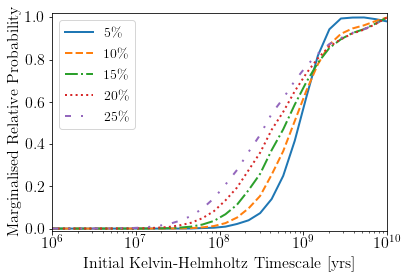

In [235]:
plt.semilogx(tkh_init_grid,L_int_Mc0a/np.amax(L_int_Mc0a),lw=2,label=r'5\%')
plt.semilogx(tkh_init_grid,L_int_Mc/np.amax(L_int_Mc),'--',lw=2,label=r'10\%')
plt.semilogx(tkh_init_grid,L_int_Mc2a/np.amax(L_int_Mc2a),'-.',lw=2,label=r'15\%')
plt.semilogx(tkh_init_grid,L_int_Mc3a/np.amax(L_int_Mc3a),':',lw=2,label=r'20\%')
plt.semilogx(tkh_init_grid,L_int_Mc4a/np.amax(L_int_Mc4a),linestyle=(0, (3, 5, 1, 5, 1, 5)),lw=2,label=r'25\%')
plt.xlim((1e6,1e10))
#ax[1,1].fill_between([1e6,1e7],[-0.5,-0.5],[2.,2.],alpha=0.5)
plt.ylim((-0.01,1.02))
#ax[1,1].text(1.1e6,0.8,"Consistent \n with vanilla \n scenario",fontsize=14)
#ax[1,1].text(3e7,0.85,"Requires \n boil-off",fontsize=14)
plt.xlabel('Initial Kelvin-Helmholtz Timescale [yrs]',fontsize=16)
plt.ylabel('Marginalised Relative Probability',fontsize=16)
plt.legend(loc=0,fontsize=14)
plt.savefig('/home/jeowen/Dropbox/Apps/Overleaf/Young_planets/Vary_Error.pdf',bbox_inches='tight')

In [361]:
age_test = np.logspace(1.,2.5,12.)
KH_limit_age = np.zeros(np.size(age_test))

tkh_init_grid = np.logspace(5.,10.,30)

Mp_index=10
X_index=48
Lum_index=25

for q in range(np.size(age_test)):
    
    age_actual = age_test[q]
    
    time_after_disc = np.linspace(age_test[q]-max(9.,0.3*age_test[q]),age_test[q]+max(20.,0.3*age_test[q]),30)
    
    print(time_after_disc)
                                  
    Lik1b = np.zeros((np.size(Mcore_grid_big),Nenv,np.size(tkh_init_grid),np.size(time_after_disc)))

    Rp_measure = data_big[Mp_index].evol[X_index][Lum_index].get_rad(age_actual*1e6)
    Rp_error = 0.1*Rp_measure
    Mp_measure = data_big[Mp_index].evol[X_index][Lum_index].get_mass(age_actual*1e6)
    Mp_error = 0.1 *Mp_measure
                                      

    log_tkh_init_array = np.zeros((np.size(Mcore_grid_big),Nenv,NL))+np.nan

    for kM in range(np.size(Mcore_grid_big)):
        for i in range(Nenv):
            Rp_vs_L_M = np.zeros(NL) + np.nan
            Mp_vs_L_M = np.zeros(NL) + np.nan
            lg_tkh_init = np.zeros(NL) + np.nan
            Rp_bondi_init = np.zeros(NL) + np.nan
            for l in range(np.size(time_after_disc)):
                age = time_after_disc[l]*1e6 + 3e6
                star_age = time_after_disc[l]*1e6 + 3e6
                for j in range(NL):
                    if (data_big[kM].evol[i][j].exist):
                        if (data_big[kM].evol[i][j].Rp_Rb_init < 0.33):
                            log_tkh_init_array[kM,i,j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                            lg_tkh_init[j] = np.log10(data_big[kM].evol[i][j].tkh_init)
                            Rp_vs_L_M[j] = data_big[kM].evol[i][j].get_rad(age)
                            Mp_vs_L_M[j] = data_big[kM].evol[i][j].get_mass(age)
                            Rp_bondi_init[j] = data_big[kM].evol[i][j].Rp_Rb_init
                
                
                # calculate radius on the tkh_init_grid
                # remove the nans
                lg_tkh_init2 = lg_tkh_init[~np.isnan(lg_tkh_init)]
                Rp_vs_L_M2 = Rp_vs_L_M[~np.isnan(lg_tkh_init)]
                Mp_vs_L_M2 = Mp_vs_L_M[~np.isnan(lg_tkh_init)]
                Rp_bondi_init2 = Rp_bondi_init[~np.isnan(lg_tkh_init)]
            
                if (np.size(lg_tkh_init2) >= 2):
                    get_Rp_age = interp1d(lg_tkh_init2,Rp_vs_L_M2,bounds_error=False)
                    get_Mp_age = interp1d(lg_tkh_init2,Mp_vs_L_M2,bounds_error=False)
                    get_bondi = interp1d(lg_tkh_init2,Rp_bondi_init2,bounds_error=False)
                    Rp_out = get_Rp_age(np.log10(tkh_init_grid))
                    Mp_out = get_Mp_age(np.log10(tkh_init_grid))
                    bondi_out = get_bondi(np.log10(tkh_init_grid))
                    Rp_out[bondi_out>0.2] = np.nan
                    Mp_out[bondi_out>0.2] = np.nan
                    # calculate likihood
                    Lik1b[kM,i,:,l] = np.exp(-(Mp_out-Mp_measure)**2./(2.*Mp_error**2.))*np.exp(-(Rp_out-Rp_measure)**2./(2.*Rp_error**2.))
                    Lik1b[kM,i,:,l] *= get_prob_phot(time_after_disc[l],age_actual,0.1*age_actual,1.,3.)
                
    Lik1b[np.isnan(Lik1b)] = 0.
    Lik1b_ = np.trapz(Lik1b,time_after_disc,axis=3)
    L_int_X1b = -np.trapz(Lik1b_,np.log10(Xgrid),axis=1)
    L_int1_Mc1b = np.trapz(Lik1b_,Mcore_grid_big,axis=0)
    L_int1_tkh1b = np.trapz(Lik1b_,np.log10(tkh_init_grid),axis=2)
    L_int_Mc1b = np.trapz(L_int_X1b,Mcore_grid_big,axis=0)
    
    # now calculate the 99% upper-limit
    from scipy.integrate import cumtrapz
    cum_prob = cumtrapz(L_int_Mc1b,np.log10(tkh_init_grid),initial=1e-6)/np.trapz(L_int_Mc1b,np.log10(tkh_init_grid))
    get_prob = interp1d(np.log10(cum_prob),np.log10(tkh_init_grid))
    KH_limit_age[q] = 10.**get_prob(np.log10(0.01))

[ 1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14. 15. 16. 17. 18.
 19. 20. 21. 22. 23. 24. 25. 26. 27. 28. 29. 30.]


/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:61: RuntimeWarning: invalid value encountered in greater
/home/jeowen/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in greater


[ 4.6887451  5.6887451  6.6887451  7.6887451  8.6887451  9.6887451
 10.6887451 11.6887451 12.6887451 13.6887451 14.6887451 15.6887451
 16.6887451 17.6887451 18.6887451 19.6887451 20.6887451 21.6887451
 22.6887451 23.6887451 24.6887451 25.6887451 26.6887451 27.6887451
 28.6887451 29.6887451 30.6887451 31.6887451 32.6887451 33.6887451]
[ 9.73817423 10.73817423 11.73817423 12.73817423 13.73817423 14.73817423
 15.73817423 16.73817423 17.73817423 18.73817423 19.73817423 20.73817423
 21.73817423 22.73817423 23.73817423 24.73817423 25.73817423 26.73817423
 27.73817423 28.73817423 29.73817423 30.73817423 31.73817423 32.73817423
 33.73817423 34.73817423 35.73817423 36.73817423 37.73817423 38.73817423]
[16.65020906 17.65020906 18.65020906 19.65020906 20.65020906 21.65020906
 22.65020906 23.65020906 24.65020906 25.65020906 26.65020906 27.65020906
 28.65020906 29.65020906 30.65020906 31.65020906 32.65020906 33.65020906
 34.65020906 35.65020906 36.65020906 37.65020906 38.65020906 39.65020906
 40.65

(10.0, 300.0)

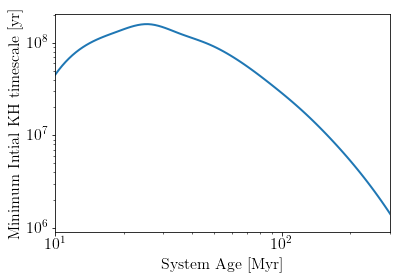

In [364]:
get_KH_age = interp1d(np.log10(age_test),np.log10(KH_limit_age),kind='cubic')
age_array = np.logspace(1.000001,2.499999,100)

plt.loglog(age_array,10.**get_KH_age(np.log10(age_array)),lw=2)
plt.xlabel('System Age [Myr]',fontsize=16)
plt.ylabel('Minimum Intial KH timescale [yr]',fontsize=16)
plt.xlim((10.,300.))


In [405]:
time = np.logspace(np.log10(3.00001e6),np.log10(6e9),200)

Mp_index=13
print(Mcore_grid_big[Mp_index])
X_index=76
print(Xgrid[X_index])
Lum_index=19
print(data_big[Mp_index].evol[X_index][Lum_index].tkh_init/1e8)
Lum_index2=36
print(data_big[Mp_index].evol[X_index][Lum_index2].tkh_init/1e6)

Rp = data_big[Mp_index].evol[X_index][Lum_index].get_rad(time)
Mp = data_big[Mp_index].evol[X_index][Lum_index].get_mass(time)
Rp2 = data_big[Mp_index].evol[X_index][Lum_index2].get_rad(time)
Mp2 = data_big[Mp_index].evol[X_index][Lum_index2].get_mass(time)

X_index=63
print(Xgrid[X_index])
Lum_index3=22
print(data_big[Mp_index].evol[X_index][Lum_index3].tkh_init/1e8)
Lum_index4=39
print(data_big[Mp_index].evol[X_index][Lum_index4].tkh_init/1e6)

Rp3 = data_big[Mp_index].evol[X_index][Lum_index3].get_rad(time)
Mp3 = data_big[Mp_index].evol[X_index][Lum_index3].get_mass(time)
Rp4 = data_big[Mp_index].evol[X_index][Lum_index4].get_rad(time)
Mp4 = data_big[Mp_index].evol[X_index][Lum_index4].get_mass(time)

4.9375
0.04039235853150905
4.831332343915241
9.6587709902671
0.10369266382873439
5.279408670469532
9.656508400608907


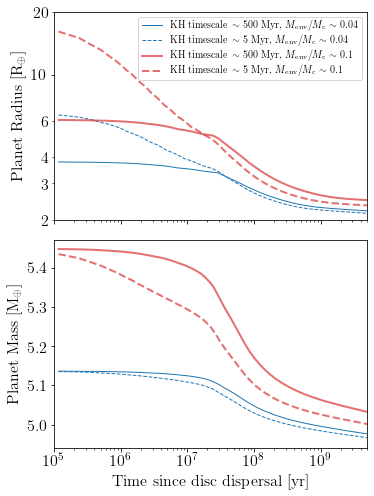

In [457]:
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(5.3,7),sharex=True)

from matplotlib.ticker import ScalarFormatter
from matplotlib.ticker import FormatStrFormatter, MaxNLocator, AutoLocator, AutoMinorLocator, FixedLocator


ax1.loglog(time-3e6,Rp,'C0',lw=1, label=r'KH timescale $\sim$ 500 Myr, $M_{\rm env}/M_{\rm c}$ $\sim$ 0.04')
ax1.loglog(time-3e6,Rp2,'C0--',lw=1,label=r'KH timescale $\sim$ 5 Myr, $M_{\rm env}/M_{\rm c}$ $\sim$ 0.04')
ax1.loglog(time-3e6,Rp3,'C3',lw=2,alpha=0.66, label=r'KH timescale $\sim$ 500 Myr, $M_{\rm env}/M_{\rm c}$ $\sim$ 0.1')
ax1.loglog(time-3e6,Rp4,'C3--',lw=2,alpha=0.66,label=r'KH timescale $\sim$ 5 Myr, $M_{\rm env}/M_{\rm c}$ $\sim$ 0.1')


ax1.legend(loc=0)



ax1.yaxis.set_minor_locator(FixedLocator([2,3,4,6,20]))

ax1.yaxis.set_major_formatter(FormatStrFormatter("%.0f"))
ax1.yaxis.set_minor_formatter(ScalarFormatter())



ax1.set_xlim((1e5,5e9))
ax1.set_ylim((2.,20.))


ax2.set_xlabel('Time since disc dispersal [yr]',fontsize=16)
ax1.set_ylabel(r'Planet Radius [R$_\oplus$]',fontsize=16)

ax2.semilogx(time-3e6,Mp,'C0',lw=1)
ax2.semilogx(time-3e6,Mp2,'C0--',lw=1)
ax2.semilogx(time-3e6,Mp3,'C3',lw=2,alpha=0.66)
ax2.semilogx(time-3e6,Mp4,'C3--',lw=2,alpha=0.66)
ax2.set_ylabel(r'Planet Mass [M$_\oplus$]',fontsize=16)

plt.tight_layout()

plt.savefig('/home/jeowen/Dropbox/Apps/Overleaf/Young_planets/simple_evolve_2.pdf',bbox_inches='tight')